1) LOAD THE DATA

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# Loading the data
import os
import pandas as pd
from glob import glob

def load_metadata(base_path, category_name):
    data = []
    if not os.path.exists(base_path):
        print(f"Warning: {category_name} path does not exist: {base_path}")
        return pd.DataFrame()
    scanners = [d for d in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, d))]
    for scanner in scanners:
        scanner_path = os.path.join(base_path, scanner)
        dpis = [d for d in os.listdir(scanner_path) if os.path.isdir(os.path.join(scanner_path, d))]
        for dpi in dpis:
            dpi_path = os.path.join(scanner_path, dpi)
            images = (glob(os.path.join(dpi_path, '*.tif')) +
                      glob(os.path.join(dpi_path, '*.tiff')) +
                      glob(os.path.join(dpi_path, '*.jpg')) +
                      glob(os.path.join(dpi_path, '*.png')))
            for img_path in images:
                data.append({
                    "file_path": img_path,
                    "scanner_model": scanner,
                    "dpi": dpi,
                    "category": category_name
                })
    return pd.DataFrame(data)

# Define paths
official_path = "/content/drive/MyDrive/Obj1/Official"
wiki_path = "/content/drive/MyDrive/Obj1/Wikipedia"

# Load into separate DataFrames
df_official = load_metadata(official_path, "official")
df_wiki = load_metadata(wiki_path, "wikipedia")

# Print counts
print(f"Total official images: {len(df_official)}")
print(f"Total wikipedia images: {len(df_wiki)}")

# Show head of each DataFrame (optional)
print(df_official.head())
print(df_wiki.head())

Total official images: 2200
Total wikipedia images: 2368
                                           file_path scanner_model  dpi  \
0  /content/drive/MyDrive/Obj1/Official/Canon120-...    Canon120-1  150   
1  /content/drive/MyDrive/Obj1/Official/Canon120-...    Canon120-1  150   
2  /content/drive/MyDrive/Obj1/Official/Canon120-...    Canon120-1  150   
3  /content/drive/MyDrive/Obj1/Official/Canon120-...    Canon120-1  150   
4  /content/drive/MyDrive/Obj1/Official/Canon120-...    Canon120-1  150   

   category  
0  official  
1  official  
2  official  
3  official  
4  official  
                                           file_path scanner_model  dpi  \
0  /content/drive/MyDrive/Obj1/Wikipedia/EpsonV39...    EpsonV39-2  300   
1  /content/drive/MyDrive/Obj1/Wikipedia/EpsonV39...    EpsonV39-2  300   
2  /content/drive/MyDrive/Obj1/Wikipedia/EpsonV39...    EpsonV39-2  300   
3  /content/drive/MyDrive/Obj1/Wikipedia/EpsonV39...    EpsonV39-2  300   
4  /content/drive/MyDrive/Obj1/Wi

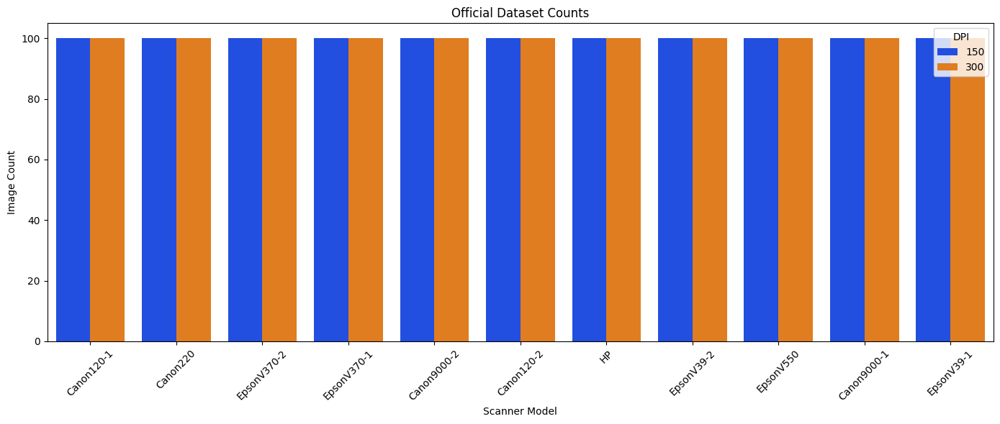

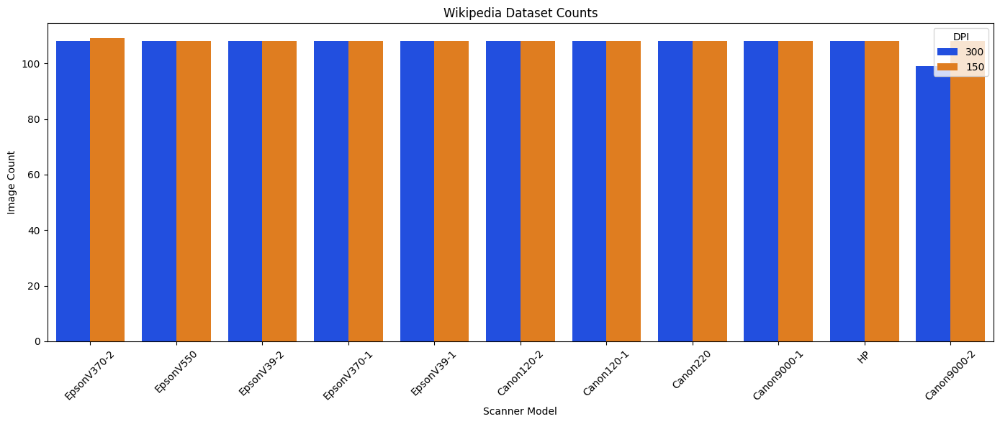

In [ ]:
#visual representation of dataset count
import matplotlib.pyplot as plt
import seaborn as sns

# Plot for OFFICIAL dataset
plt.figure(figsize=(14,6))
sns.countplot(
    data=df_official,
    x='scanner_model',
    hue='dpi',
    order=df_official['scanner_model'].value_counts().index,
    palette='bright'
)
plt.title('Official Dataset Counts')
plt.xlabel('Scanner Model')
plt.ylabel('Image Count')
plt.xticks(rotation=45)
plt.legend(title='DPI')
plt.tight_layout()
plt.show()

# Plot for WIKIPEDIA dataset
plt.figure(figsize=(14,6))
sns.countplot(
    data=df_wiki,
    x='scanner_model',
    hue='dpi',
    order=df_wiki['scanner_model'].value_counts().index,
    palette='bright'
)
plt.title('Wikipedia Dataset Counts')
plt.xlabel('Scanner Model')
plt.ylabel('Image Count')
plt.xticks(rotation=45)
plt.legend(title='DPI')
plt.tight_layout()
plt.show()


Loaded 22 flatfield images
                                           file_path scanner_model  dpi
0  /content/drive/MyDrive/Obj1/Flatfield/Canon120...    Canon120-1  300
1  /content/drive/MyDrive/Obj1/Flatfield/Canon120...    Canon120-1  150
2  /content/drive/MyDrive/Obj1/Flatfield/EpsonV39...    EpsonV39-1  300
3  /content/drive/MyDrive/Obj1/Flatfield/EpsonV39...    EpsonV39-1  150
4  /content/drive/MyDrive/Obj1/Flatfield/Canon120...    Canon120-2  300


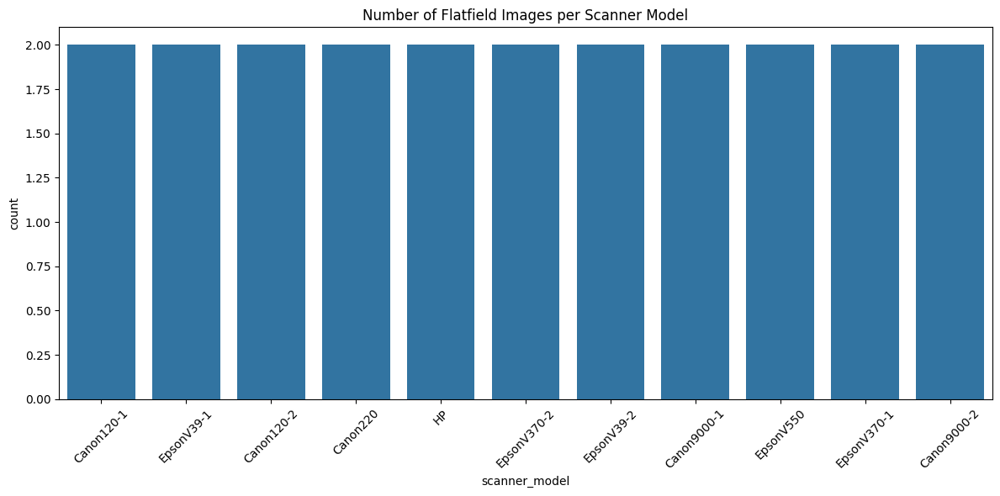

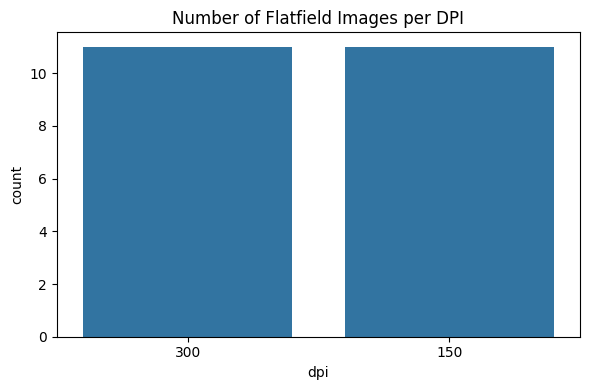

In [ ]:
#Flatfield images loading and image count
import os
import cv2
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
import concurrent.futures

# --- Load flatfield metadata, filtering out hidden/system files ---
def load_flatfield_metadata(base_path):
    data = []
    if not os.path.exists(base_path):
        print(f"Path does not exist: {base_path}")
        return pd.DataFrame()
    scanners = [d for d in os.listdir(base_path) if os.path.isdir(os.path.join(base_path, d))]
    for scanner in scanners:
        scanner_path = os.path.join(base_path, scanner)
        for fname in os.listdir(scanner_path):
            if fname.startswith('.') or fname.startswith('._'):
                continue
            if not (fname.lower().endswith('.tif') or fname.lower().endswith('.tiff')):
                continue
            dpi = os.path.splitext(fname)[0]
            if dpi not in ['150', '300']:
                dpi = None
            img_path = os.path.join(scanner_path, fname)
            data.append({'file_path': img_path,
                         'scanner_model': scanner,
                         'dpi': dpi})
    return pd.DataFrame(data)

# Set your flatfield images folder path here
flatfield_path = "/content/drive/MyDrive/Obj1/Flatfield"
df_flatfield = load_flatfield_metadata(flatfield_path)

print(f"Loaded {len(df_flatfield)} flatfield images")
print(df_flatfield.head())

# --- Visualization of image counts per scanner model and dpi ---
plt.figure(figsize=(12,6))
sns.countplot(data=df_flatfield, x='scanner_model', order=df_flatfield['scanner_model'].value_counts().index)
plt.title('Number of Flatfield Images per Scanner Model')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

plt.figure(figsize=(6,4))
sns.countplot(data=df_flatfield, x='dpi')
plt.title('Number of Flatfield Images per DPI')
plt.tight_layout()
plt.show()

2) Preprocess the data

In [ ]:
#Preprocessing the Flatfield images
import os
import pickle
import cv2
import numpy as np
from tqdm import tqdm

# ---------------------------
# 1) Locate the Flatfield folder
# ---------------------------
def locate_flatfield(root_dir="/content/drive/MyDrive/Obj1"):
    candidates = []
    for root, dirs, files in os.walk(root_dir):
        for d in dirs:
            if d.lower() == "flatfield":  # ignore case
                candidates.append(os.path.join(root, d))
    return candidates

flatfield_dirs = locate_flatfield("/content/drive/MyDrive/Obj1")
if not flatfield_dirs:
    raise FileNotFoundError("❌ 'Flatfield' folder not found in your Drive. Please upload your dataset.")
else:
    FLATFIELD_DIR = flatfield_dirs[0]    # use the first found
    BASE_DIR = os.path.dirname(FLATFIELD_DIR)
    OUT_PICKLE = os.path.join(BASE_DIR, "flatfield_residuals.pkl")
    print("✅ Located Flatfield folder at:", FLATFIELD_DIR)
    print("Residuals will be saved to:", OUT_PICKLE)

# ---------------------------
# 2) Import denoising (wavelet/wiener)
# ---------------------------
try:
    from skimage.restoration import denoise_wavelet
except ImportError:
    import subprocess
    subprocess.run(["pip", "install", "scikit-image"])
    from skimage.restoration import denoise_wavelet
from scipy.signal import wiener as scipy_wiener

# ---------------------------
# 3) Parameters
# ---------------------------
IMG_SHAPE = (256, 256)
DENOISE = "wavelet"  # Can be "wavelet" or "wiener"

# ---------------------------
# 4) Residual Extraction Function
# ---------------------------
def get_residual(img_path, img_shape=IMG_SHAPE, denoise_method=DENOISE):
    img = cv2.imread(img_path, cv2.IMREAD_UNCHANGED)
    if img is None:
        return None
    if img.ndim == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img = cv2.resize(img, img_shape, interpolation=cv2.INTER_AREA)
    img = img.astype(np.float32) / 255.0
    if denoise_method == "wiener":
        denoised = scipy_wiener(img, mysize=(5, 5))
    else:
        denoised = denoise_wavelet(img, channel_axis=None, rescale_sigma=True)
    return (img - denoised).astype(np.float32)

# ---------------------------
# 5) Process all Flatfield images
# ---------------------------
all_residuals = {}
scanners = sorted(os.listdir(FLATFIELD_DIR))

for scanner in tqdm(scanners, desc="Scanners"):
    scanner_dir = os.path.join(FLATFIELD_DIR, scanner)
    if not os.path.isdir(scanner_dir):
        continue
    res_list = []
    for fname in sorted(os.listdir(scanner_dir)):
        if fname.startswith("._"):
            continue
        if not fname.lower().endswith((".tif", ".tiff", ".png", ".jpg", ".jpeg")):
            continue
        img_path = os.path.join(scanner_dir, fname)
        try:
            residual = get_residual(img_path, IMG_SHAPE, DENOISE)
            if residual is not None:
                res_list.append(residual)
        except Exception as e:
            print(f"⚠️ Error with {img_path}: {e}")
    if res_list:
        all_residuals[scanner] = res_list
    else:
        print(f"⚠️ No valid flatfield images for scanner: {scanner}")

# ---------------------------
# 6) Save residuals as pickle
# ---------------------------
with open(OUT_PICKLE, "wb") as f:
    pickle.dump(all_residuals, f)

# ---------------------------
# 7) Print Summary
# ---------------------------
tot_scanners = len(all_residuals)
tot_images = sum(len(v) for v in all_residuals.values())
print(f"\n✅ Finished. Extracted residuals for {tot_scanners} scanners, {tot_images} images.")
print("Sample scanners:", list(all_residuals.keys())[:5])


✅ Located Flatfield folder at: /content/drive/MyDrive/Obj1/Flatfield
Residuals will be saved to: /content/drive/MyDrive/Obj1/flatfield_residuals.pkl


Scanners: 100%|██████████| 11/11 [00:01<00:00,  6.37it/s]


✅ Finished. Extracted residuals for 11 scanners, 22 images.
Sample scanners: ['Canon120-1', 'Canon120-2', 'Canon220', 'Canon9000-1', 'Canon9000-2']


In [ ]:
#Preprocessing the Official and Wikipedia images
import os
import cv2
import numpy as np
import pickle
from tqdm import tqdm
import pywt
from concurrent.futures import ThreadPoolExecutor, as_completed

OFFICIAL_DIR = "/content/drive/MyDrive/Obj1/Official"
WIKI_DIR = "/content/drive/MyDrive/Obj1/Wikipedia"
OUT_PATH = "/content/drive/MyDrive/Obj1/residuals_official_wiki.pkl"

def to_gray(img):
    return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY) if img.ndim == 3 else img

def resize_to(img, size=(256,256)):
    return cv2.resize(img, size, interpolation=cv2.INTER_AREA)

def normalize_img(img):
    return img.astype(np.float32) / 255.0

def denoise_wavelet(img):
    coeffs = pywt.dwt2(img, 'haar')
    cA, (cH, cV, cD) = coeffs
    cH[:], cV[:], cD[:] = 0, 0, 0  # Zero detail coefficients
    return pywt.idwt2((cA, (cH, cV, cD)), 'haar')

def compute_residual(img):
    denoised = denoise_wavelet(img)
    return img - denoised

def process_single_image(fpath):
    img = cv2.imread(fpath, cv2.IMREAD_COLOR)
    if img is None:
        return None
    gray = to_gray(img)
    gray = resize_to(gray, (256, 256))
    gray = normalize_img(gray)
    return compute_residual(gray)

def process_dataset(base_dir, dataset_name, residuals_dict):
    print(f"🔄 Preprocessing {dataset_name} images...")

    for scanner in tqdm(os.listdir(base_dir), desc=f"{dataset_name} scanners"):
        scanner_path = os.path.join(base_dir, scanner)
        if not os.path.isdir(scanner_path):
            continue

        residuals_dict[dataset_name][scanner] = {}

        for dpi in os.listdir(scanner_path):   # e.g. 150, 300, etc.
            dpi_path = os.path.join(scanner_path, dpi)
            if not os.path.isdir(dpi_path):
                continue

            files = [os.path.join(dpi_path, f) for f in os.listdir(dpi_path)
                     if f.lower().endswith(('.tif','.tiff','.jpg','.jpeg','.png'))]

            dpi_residuals = []
            # Parallel processing
            with ThreadPoolExecutor(max_workers=8) as executor:
                futures = [executor.submit(process_single_image, f) for f in files]
                for fut in as_completed(futures):
                    res = fut.result()
                    if res is not None:
                        dpi_residuals.append(res)

            residuals_dict[dataset_name][scanner][dpi] = dpi_residuals

residuals_dict = {"official": {}, "wikipedia": {}}

process_dataset(OFFICIAL_DIR, "official", residuals_dict)
process_dataset(WIKI_DIR, "wikipedia", residuals_dict)

with open(OUT_PATH, "wb") as f:
    pickle.dump(residuals_dict, f)

print(f"✅ Saved residuals for both datasets (by scanner & dpi) to {OUT_PATH}")
print("Sample scanners (official):", list(residuals_dict["official"].keys())[:5])


🔄 Preprocessing official images...


official scanners: 100%|██████████| 11/11 [10:43<00:00, 58.48s/it]


🔄 Preprocessing wikipedia images...


wikipedia scanners: 100%|██████████| 11/11 [12:59<00:00, 70.83s/it]


✅ Saved residuals for both datasets (by scanner & dpi) to /content/drive/MyDrive/Obj1/residuals_official_wiki.pkl
Sample scanners (official): ['Canon120-1', 'Canon220', 'EpsonV370-2', 'EpsonV370-1', 'Canon9000-2']


In [ ]:
import os
import csv
from pathlib import Path
from collections import defaultdict

# List your dataset roots and friendly dataset labels
roots = [
    (Path("/content/drive/MyDrive/Obj1/Official"), "Official"),
    (Path("/content/drive/MyDrive/Obj1/Wikipedia"), "Wikipedia"),
]

image_exts = ('.tif', '.tiff', '.png', '.jpg', '.jpeg')
rows = []
stats = defaultdict(lambda: defaultdict(lambda: defaultdict(int)))

for root, dataset_label in roots:
    if not root.is_dir():
        print(f"⚠️ Skipping missing directory: {root}")
        continue
    for scanner_dir in sorted(root.iterdir()):
        if not scanner_dir.is_dir() or scanner_dir.name.startswith('.'):
            continue
        for dpi_dir in sorted(scanner_dir.iterdir()):
            if not dpi_dir.is_dir() or dpi_dir.name.startswith('.'):
                continue
            img_count = 0
            for img_file in sorted(dpi_dir.iterdir()):
                if img_file.name.startswith('.') or not img_file.suffix.lower() in image_exts:
                    continue
                rows.append([
                    dataset_label,
                    scanner_dir.name,
                    dpi_dir.name,
                    str(img_file.resolve())
                ])
                img_count += 1
            stats[dataset_label][scanner_dir.name][dpi_dir.name] = img_count
            if img_count == 0:
                print(f"⚠️ No images found in: {dpi_dir}")
            else:
                print(f"✅ {img_count} images: {dataset_label}/{scanner_dir.name}/{dpi_dir.name}")

out_csv = "/content/drive/MyDrive/Obj1/dataset_inventory.csv"
os.makedirs(os.path.dirname(out_csv), exist_ok=True)

with open(out_csv, "w", newline="") as fh:
    w = csv.writer(fh)
    w.writerow(["dataset", "scanner", "dpi", "path"])
    w.writerows(rows)

print(f"\nWrote inventory: {out_csv} | Total image rows: {len(rows)}")

# Print dataset structure summary
print("\n--- Dataset Structure Summary ---")
for dataset, ds_data in stats.items():
    print(f"Dataset: {dataset}")
    for scanner, sc_data in ds_data.items():
        for dpi, cnt in sc_data.items():
            print(f"  {scanner:20s} | DPI: {dpi:6s} | {cnt:4d} files")


✅ 100 images: Official/Canon120-1/150
✅ 100 images: Official/Canon120-1/300
✅ 100 images: Official/Canon120-2/150
✅ 100 images: Official/Canon120-2/300
✅ 100 images: Official/Canon220/150
✅ 100 images: Official/Canon220/300
✅ 100 images: Official/Canon9000-1/150
✅ 100 images: Official/Canon9000-1/300
✅ 100 images: Official/Canon9000-2/150
✅ 100 images: Official/Canon9000-2/300
✅ 100 images: Official/EpsonV370-1/150
✅ 100 images: Official/EpsonV370-1/300
✅ 100 images: Official/EpsonV370-2/150
✅ 100 images: Official/EpsonV370-2/300
✅ 100 images: Official/EpsonV39-1/150
✅ 100 images: Official/EpsonV39-1/300
✅ 100 images: Official/EpsonV39-2/150
✅ 100 images: Official/EpsonV39-2/300
✅ 100 images: Official/EpsonV550/150
✅ 100 images: Official/EpsonV550/300
✅ 100 images: Official/HP/150
✅ 100 images: Official/HP/300
✅ 108 images: Wikipedia/Canon120-1/150
✅ 108 images: Wikipedia/Canon120-1/300
✅ 108 images: Wikipedia/Canon120-2/150
✅ 108 images: Wikipedia/Canon120-2/300
✅ 108 images: Wikipedi

3) FEATURE EXTRACTION


In [ ]:
#Extracting Features for flatfield images
import os
import pickle
import numpy as np
from datetime import datetime

# Paths - update as needed
FLATFIELD_RESIDUALS_PATH = "/content/drive/MyDrive/Obj1/flatfield_residuals.pkl"
FP_OUT_PATH = "/content/drive/MyDrive/Obj1/scanner_fingerprints.pkl"
ORDER_NPY = "/content/drive/MyDrive/Obj1/fp_keys.npy"

def load_residuals(path):
    print(f"Loading residuals from {path}...")
    with open(path, "rb") as f:
        residuals = pickle.load(f)
    print(f"Loaded residuals for {len(residuals)} scanners.")
    return residuals

def compute_mean_fingerprint(residuals_list):
    valid_residuals = [r for r in residuals_list if r is not None and r.size > 0]
    if not valid_residuals:
        return None
    stack = np.stack(valid_residuals, axis=0)
    mean_fp = np.mean(stack, axis=0)
    # Optional normalization (zero mean, unit std)
    mean_fp = (mean_fp - mean_fp.mean()) / (mean_fp.std() + 1e-10)
    return mean_fp.astype(np.float32)

def compute_scanner_fingerprints(flatfield_residuals):
    fingerprints = {}
    for scanner, residuals in flatfield_residuals.items():
        if not residuals:
            print(f"⚠️ Scanner '{scanner}' has no residuals. Skipping.")
            continue
        fp = compute_mean_fingerprint(residuals)
        if fp is None:
            print(f"⚠️ Scanner '{scanner}' residuals invalid. Skipping.")
            continue
        fingerprints[scanner] = fp
        print(f"Computed fingerprint for '{scanner}' with shape {fp.shape}")
    return fingerprints

def save_pickle(obj, path):
    backup_path = None
    if os.path.exists(path):
        timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
        backup_path = f"{path}.backup_{timestamp}"
        os.rename(path, backup_path)
        print(f"Existing file backed up as: {backup_path}")
    with open(path, "wb") as f:
        pickle.dump(obj, f)
    print(f"Saved pickle file to {path}")

def save_scanner_order(fingerprints, path):
    keys = sorted(fingerprints.keys())
    np.save(path, np.array(keys))
    print(f"Saved scanner order to {path}: {keys}")

def main():
    residuals = load_residuals(FLATFIELD_RESIDUALS_PATH)
    fingerprints = compute_scanner_fingerprints(residuals)
    save_pickle(fingerprints, FP_OUT_PATH)
    save_scanner_order(fingerprints, ORDER_NPY)
    print(f"✅ Processing complete. Total fingerprints computed: {len(fingerprints)}")

if __name__ == "__main__":
    main()


Loading residuals from /content/drive/MyDrive/Obj1/flatfield_residuals.pkl...
Loaded residuals for 11 scanners.
Computed fingerprint for 'Canon120-1' with shape (256, 256)
Computed fingerprint for 'Canon120-2' with shape (256, 256)
Computed fingerprint for 'Canon220' with shape (256, 256)
Computed fingerprint for 'Canon9000-1' with shape (256, 256)
Computed fingerprint for 'Canon9000-2' with shape (256, 256)
Computed fingerprint for 'EpsonV370-1' with shape (256, 256)
Computed fingerprint for 'EpsonV370-2' with shape (256, 256)
Computed fingerprint for 'EpsonV39-1' with shape (256, 256)
Computed fingerprint for 'EpsonV39-2' with shape (256, 256)
Computed fingerprint for 'EpsonV550' with shape (256, 256)
Computed fingerprint for 'HP' with shape (256, 256)
Saved pickle file to /content/drive/MyDrive/Obj1/scanner_fingerprints.pkl
Saved scanner order to /content/drive/MyDrive/Obj1/fp_keys.npy: ['Canon120-1', 'Canon120-2', 'Canon220', 'Canon9000-1', 'Canon9000-2', 'EpsonV370-1', 'EpsonV370-

/usr/local/lib/python3.12/dist-packages/skimage/feature/texture.py:385: UserWarning: Applying `local_binary_pattern` to floating-point images may give unexpected results when small numerical differences between adjacent pixels are present. It is recommended to use this function with images of integer dtype.
  warnings.warn(


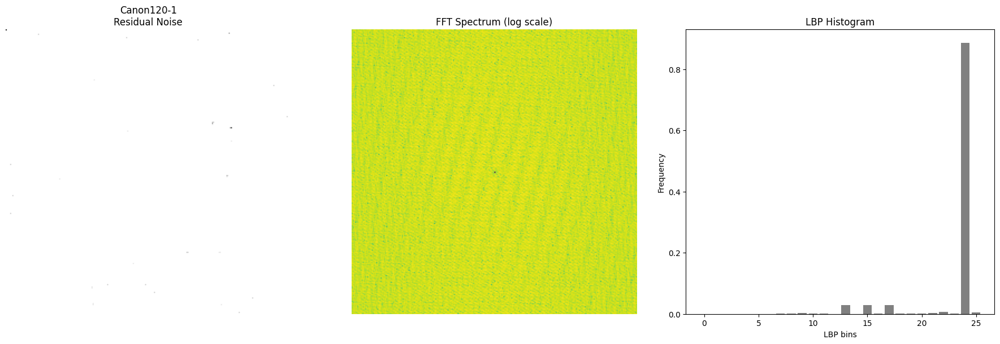

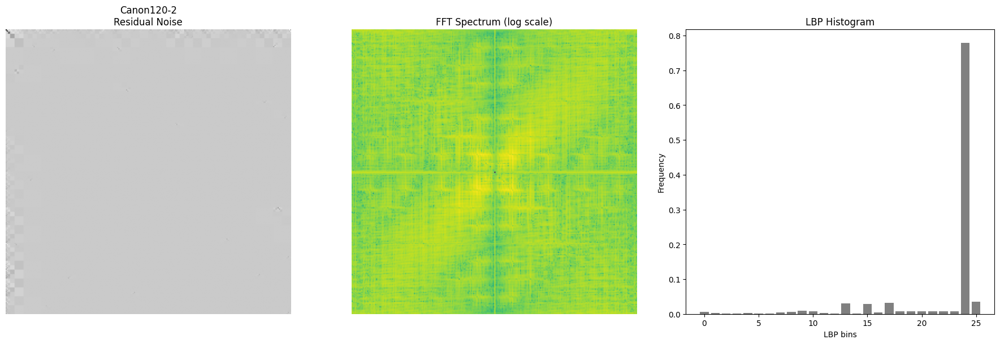

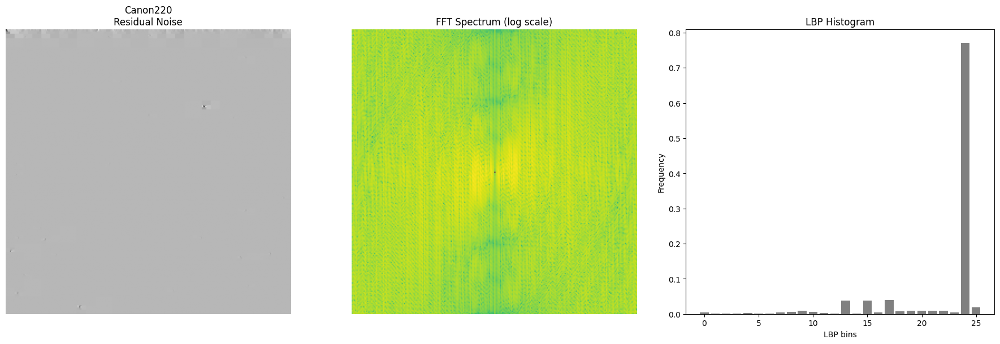

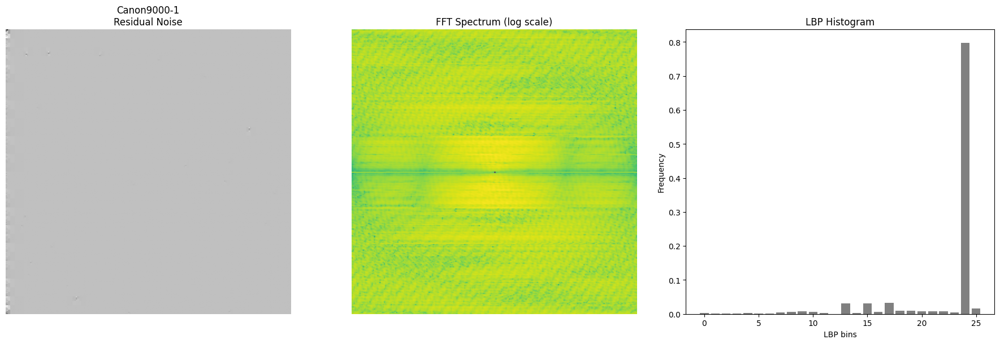

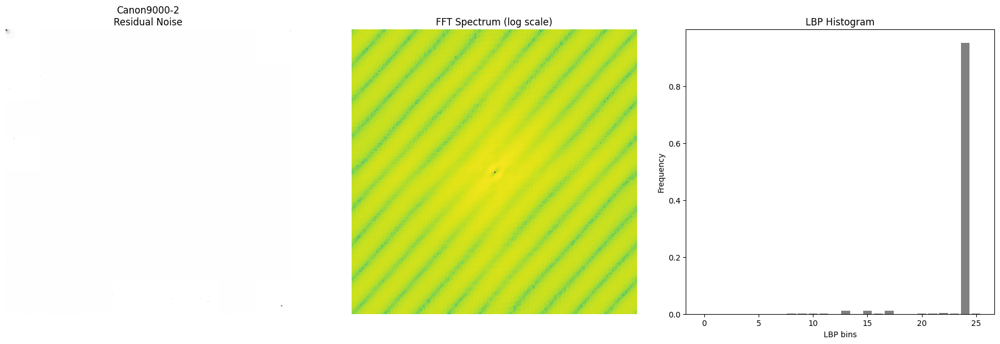

...

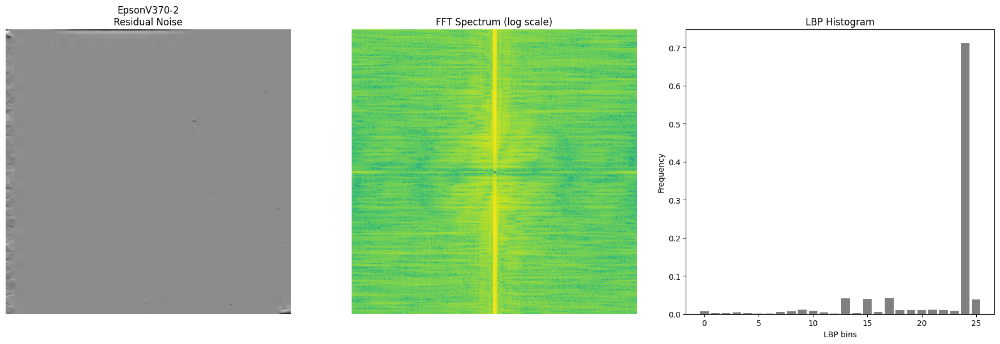

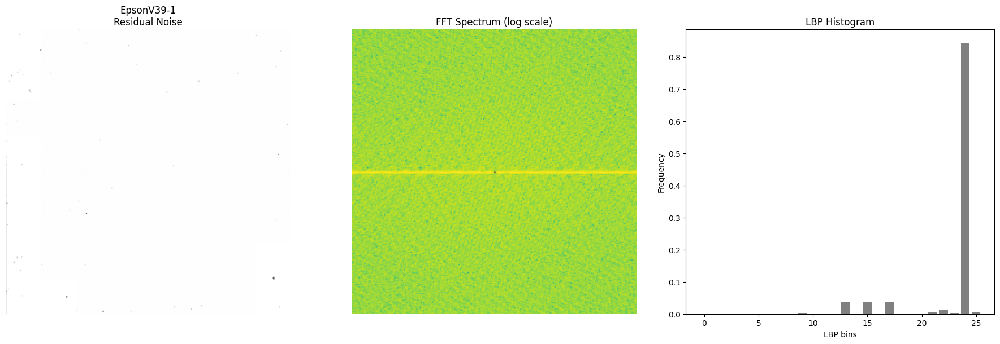

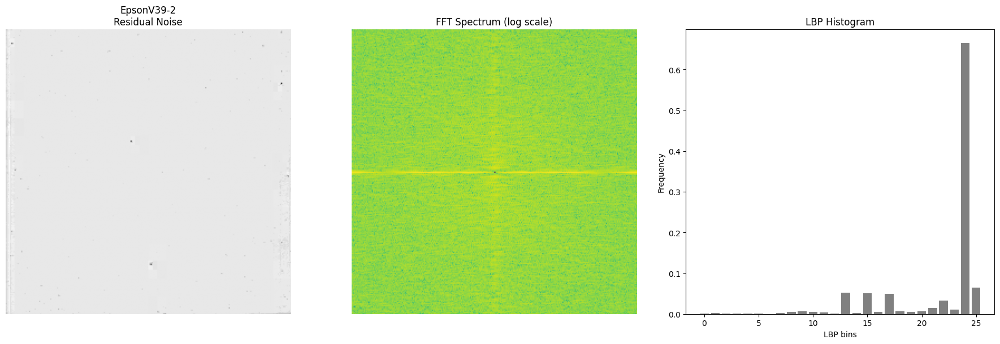

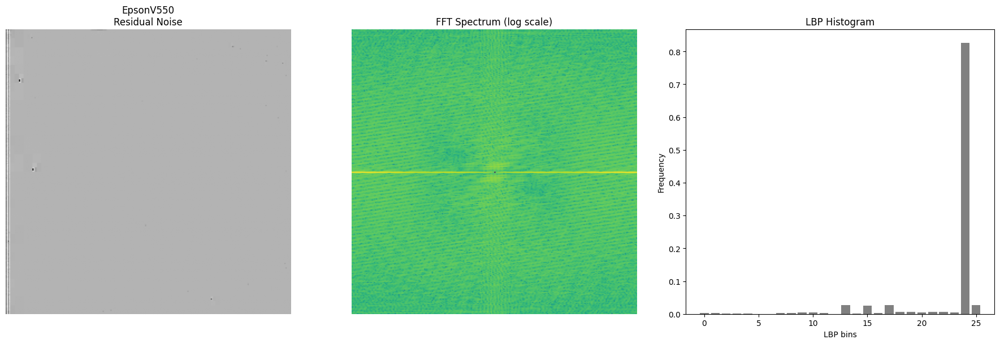

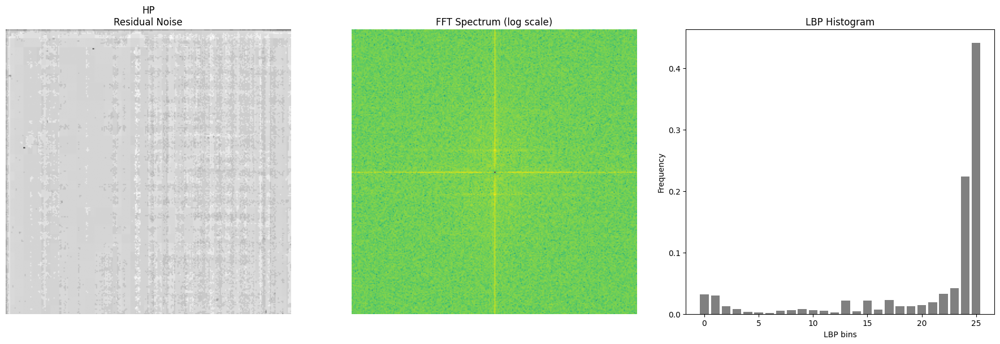

In [ ]:
#Extracting and Visualising the additional features (FFT, LBP)
import numpy as np
import matplotlib.pyplot as plt
from skimage.feature import local_binary_pattern
import pickle

# Parameters for LBP
LBP_RADIUS = 3
LBP_POINTS = 8 * LBP_RADIUS
LBP_METHOD = 'uniform'

def compute_fft_spectrum(img):
    """Compute centered FFT magnitude spectrum suitable for visualization."""
    f = np.fft.fft2(img)
    fshift = np.fft.fftshift(f)
    magnitude_spectrum = np.log(np.abs(fshift) + 1e-8)
    return magnitude_spectrum

def compute_lbp_hist(img, points=LBP_POINTS, radius=LBP_RADIUS, method=LBP_METHOD):
    """Compute LBP histogram normalized to frequency."""
    lbp = local_binary_pattern(img, points, radius, method)
    n_bins = int(points + 2)
    hist, bin_edges = np.histogram(lbp.ravel(), bins=n_bins, range=(0, n_bins), density=True)
    return hist, bin_edges

def plot_fingerprint_analysis(fingerprint, scanner_name):
    fft_spectrum = compute_fft_spectrum(fingerprint)
    lbp_hist, bins = compute_lbp_hist(fingerprint)

    fig, axs = plt.subplots(1, 3, figsize=(18,6))

    axs[0].imshow(fingerprint, cmap='gray')
    axs[0].set_title(f"{scanner_name}\nResidual Noise")
    axs[0].axis('off')

    axs[1].imshow(fft_spectrum, cmap='viridis')
    axs[1].set_title("FFT Spectrum (log scale)")
    axs[1].axis('off')

    axs[2].bar(bins[:-1], lbp_hist, width=(bins[1]-bins[0])*0.8, color='gray')
    axs[2].set_title("LBP Histogram")
    axs[2].set_xlabel("LBP bins")
    axs[2].set_ylabel("Frequency")

    plt.tight_layout()
    plt.show()

# Usage example:
with open("/content/drive/MyDrive/Obj1/scanner_fingerprints.pkl", "rb") as f:
    scanner_fingerprints = pickle.load(f)

for scanner, fingerprint in scanner_fingerprints.items():
    if fingerprint.ndim == 3:
        fingerprint = np.mean(fingerprint, axis=2)  # convert to grayscale if RGB
    plot_fingerprint_analysis(fingerprint, scanner)


In [ ]:
#Extarcting the PRNU Fingerprints for official and wikipedia images
import pickle
import numpy as np
from tqdm import tqdm

# Paths with 'Obj1' instead of 'Objective1'
RES_PATH = "/content/drive/MyDrive/Obj1/residuals_official_wiki.pkl"
FP_PATH = "/content/drive/MyDrive/Obj1/scanner_fingerprints.pkl"
ORDER_NPY = "/content/drive/MyDrive/Obj1/fp_keys.npy"
OUT_PATH = "/content/drive/MyDrive/Obj1/features.pkl"

# Load fingerprints and fixed order
with open(FP_PATH, "rb") as f:
    scanner_fps = pickle.load(f)

fp_keys = np.load(ORDER_NPY, allow_pickle=True).tolist()
print(f"✅ Loaded {len(scanner_fps)} fingerprints and key order with {len(fp_keys)} keys.")

# Normalized cross-correlation (zero-mean cosine similarity)
def corr2d(a, b):
    a = a.astype(np.float32).ravel()
    b = b.astype(np.float32).ravel()
    a -= a.mean()
    b -= b.mean()
    denom = (np.linalg.norm(a) * np.linalg.norm(b))
    return float(np.dot(a, b) / denom) if denom != 0 else 0.0

# Load residuals (precomputed)
with open(RES_PATH, "rb") as f:
    residuals_dict = pickle.load(f)

print(f"✅ Loaded residuals for datasets: {list(residuals_dict.keys())}")

features = []
labels = []

# Dynamically process all dataset keys from residuals dict
for dataset_name, dataset in residuals_dict.items():
    print(f"🔄 Computing features for dataset: {dataset_name}")
    for scanner, dpi_dict in tqdm(dataset.items(), desc=f"{dataset_name} Scanners"):
        for dpi, res_list in dpi_dict.items():
            for res in res_list:
                vec = [corr2d(res, scanner_fps[k]) for k in fp_keys]
                features.append(vec)
                labels.append(str(scanner))  # ensure label is string

# Convert to numpy arrays for efficiency
features = np.array(features, dtype=np.float32)
labels = np.array(labels)

# Save features and labels
with open(OUT_PATH, "wb") as f:
    pickle.dump({"features": features, "labels": labels}, f)

print(f"✅ Features and labels saved to {OUT_PATH}")
print(f"Features shape: {features.shape}")
print(f"Labels shape: {labels.shape}")


✅ Loaded 11 fingerprints and key order with 11 keys.
✅ Loaded residuals for datasets: ['official', 'wikipedia']
🔄 Computing features for dataset: official


official Scanners: 100%|██████████| 11/11 [00:03<00:00,  3.28it/s]


🔄 Computing features for dataset: wikipedia


wikipedia Scanners: 100%|██████████| 11/11 [00:04<00:00,  2.55it/s]

✅ Features and labels saved to /content/drive/MyDrive/Obj1/features.pkl
Features shape: (4568, 11)
Labels shape: (4568,)


🔄 Extracting enhanced features and visualizing samples...
Processing dataset: official


  0%|          | 0/11 [00:00<?, ?it/s]

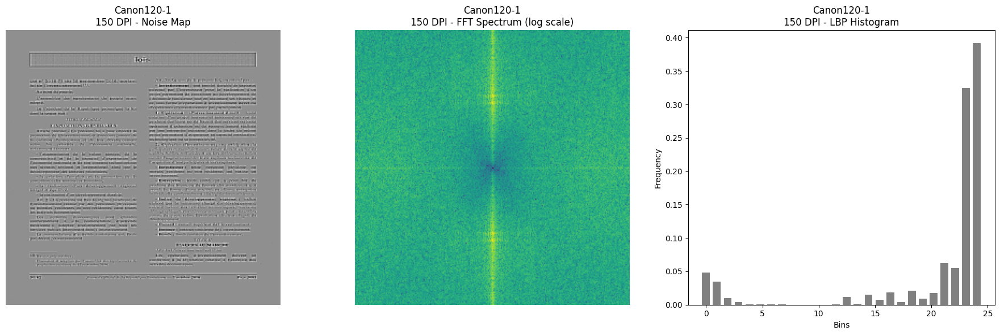

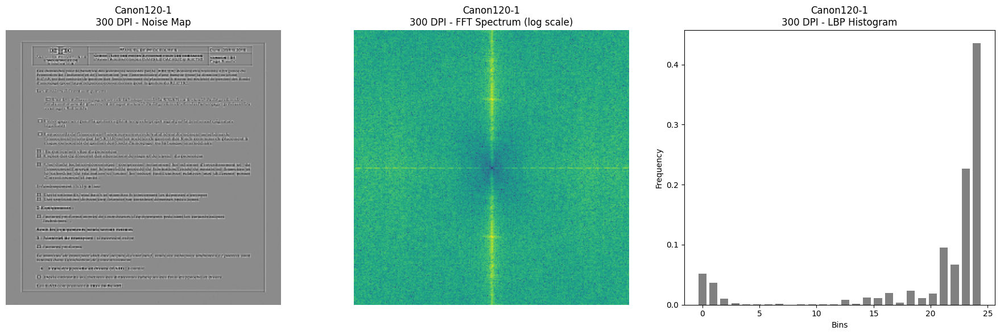

  9%|▉         | 1/11 [00:01<00:11,  1.13s/it]

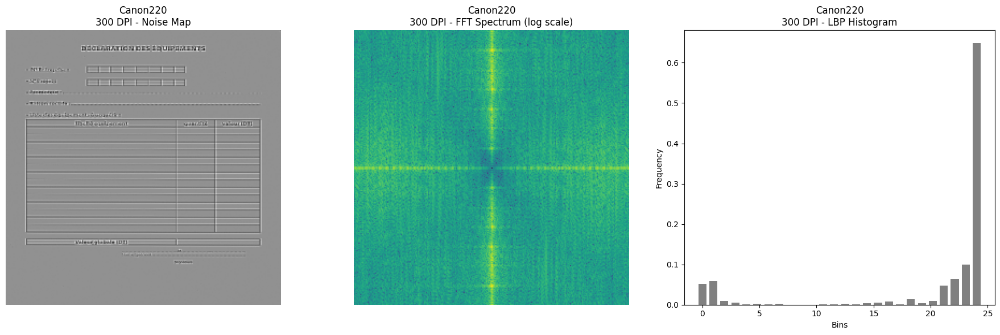

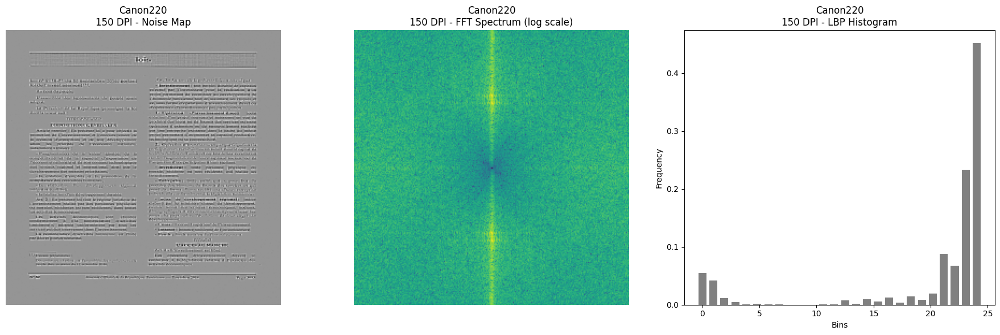

 18%|█▊        | 2/11 [00:02<00:10,  1.16s/it]

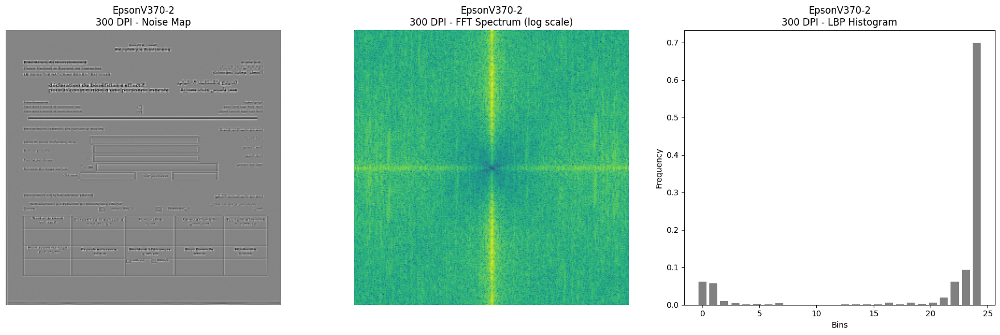

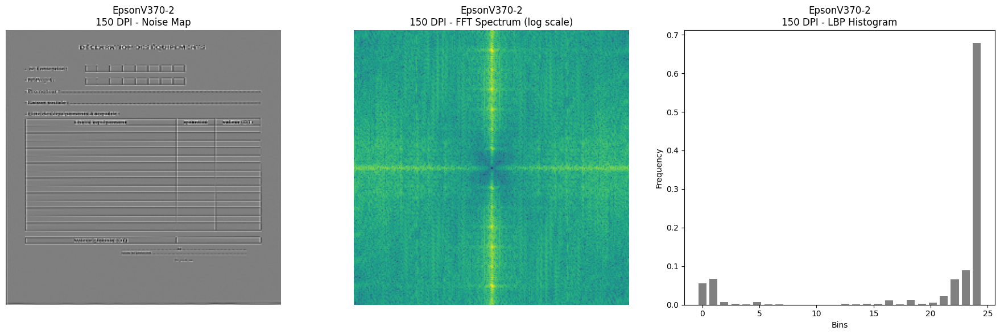

 27%|██▋       | 3/11 [00:03<00:09,  1.18s/it]

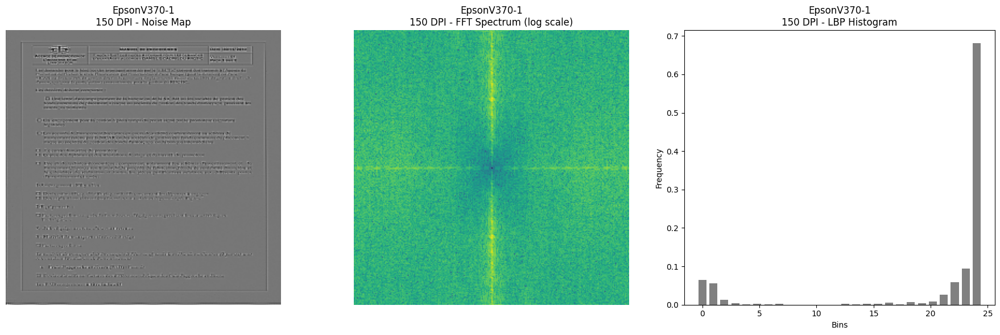

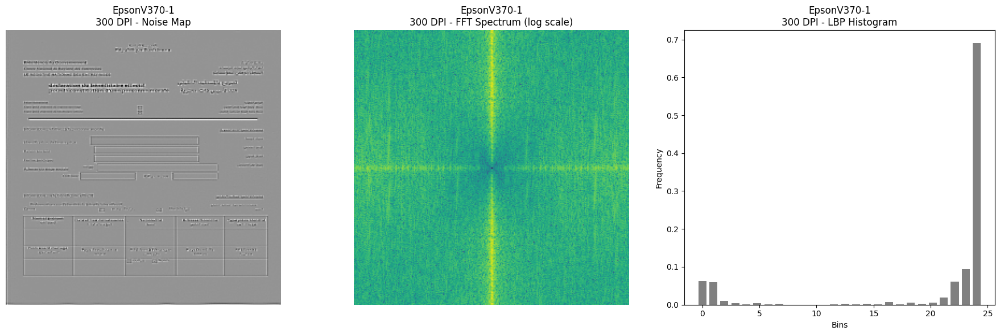

 36%|███▋      | 4/11 [00:04<00:08,  1.19s/it]

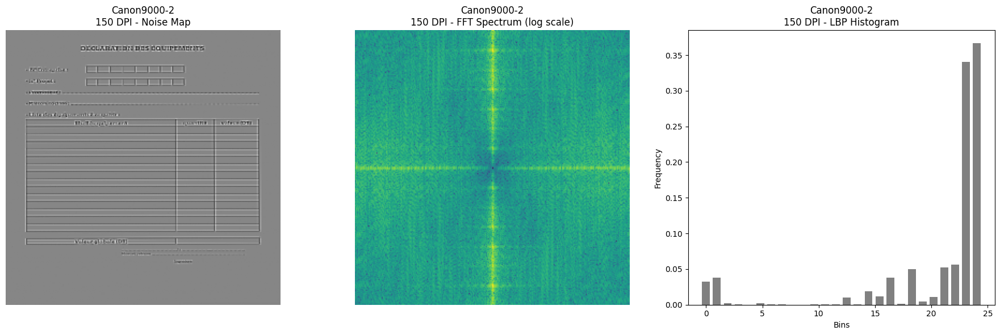

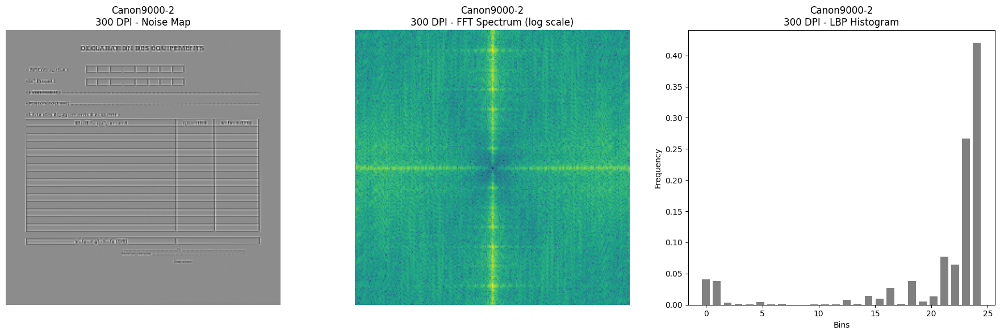

 45%|████▌     | 5/11 [00:06<00:07,  1.24s/it]

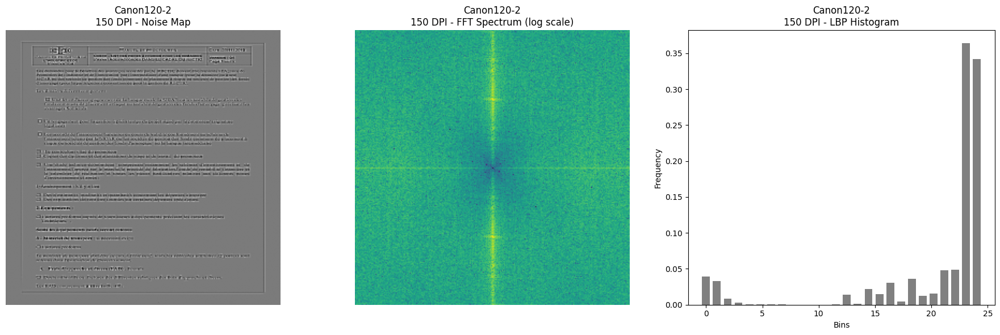

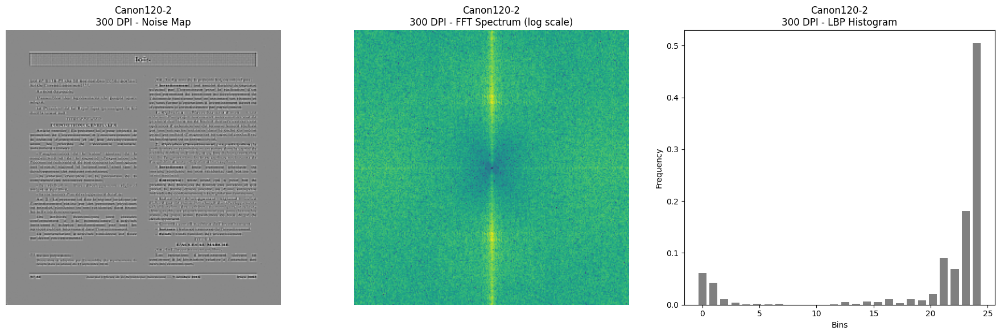

 55%|█████▍    | 6/11 [00:07<00:06,  1.39s/it]

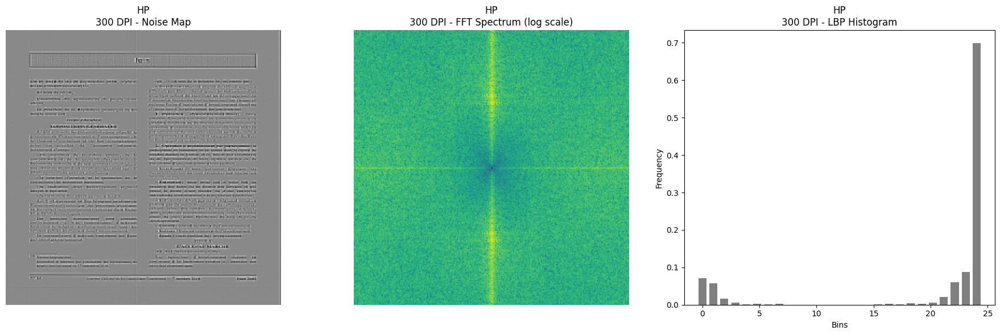

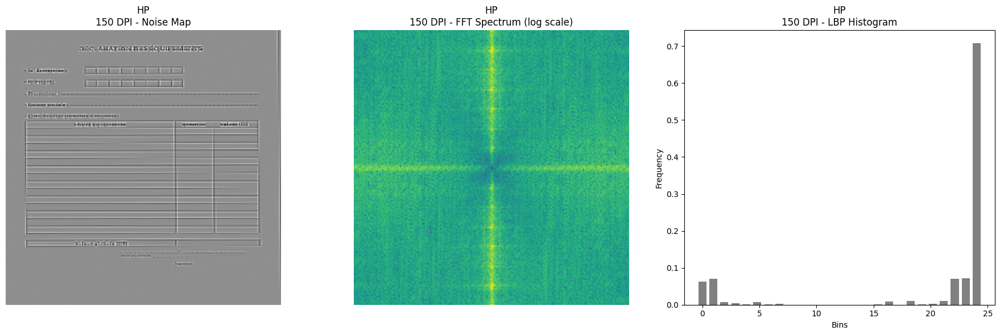

 64%|██████▎   | 7/11 [00:09<00:06,  1.52s/it]

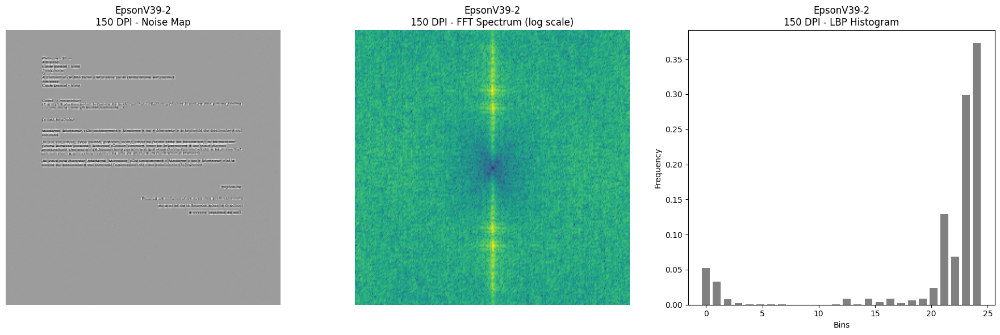

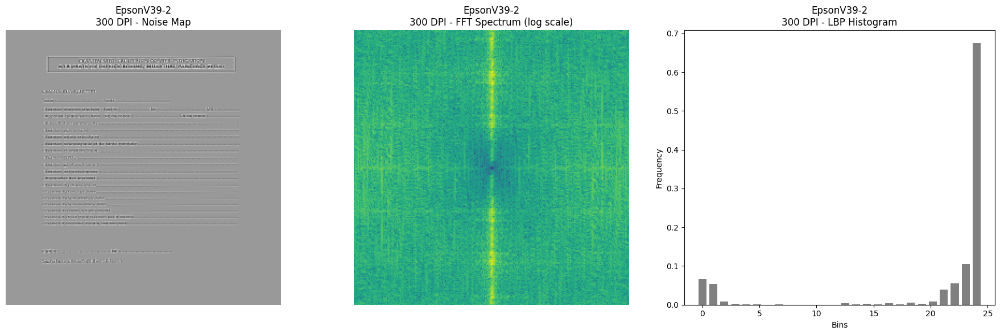

 73%|███████▎  | 8/11 [00:11<00:04,  1.60s/it]

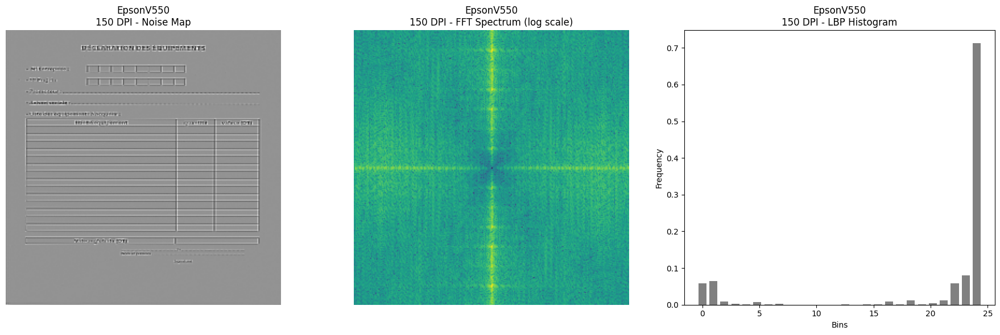

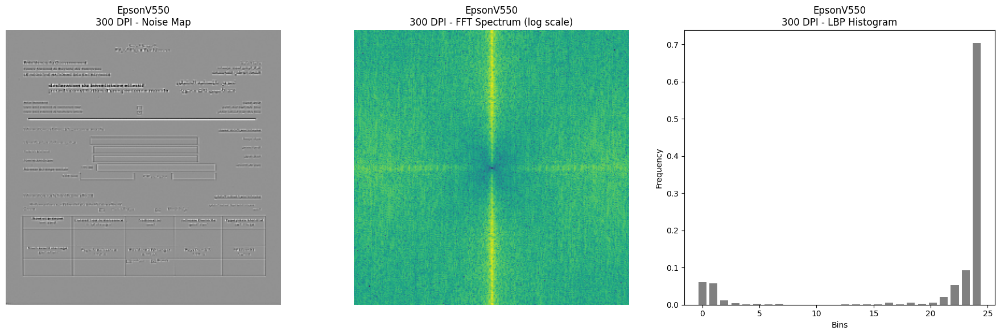

 82%|████████▏ | 9/11 [00:12<00:03,  1.55s/it]

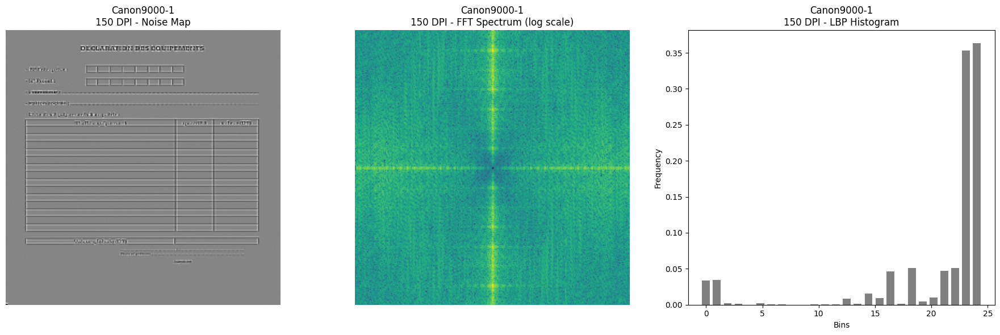

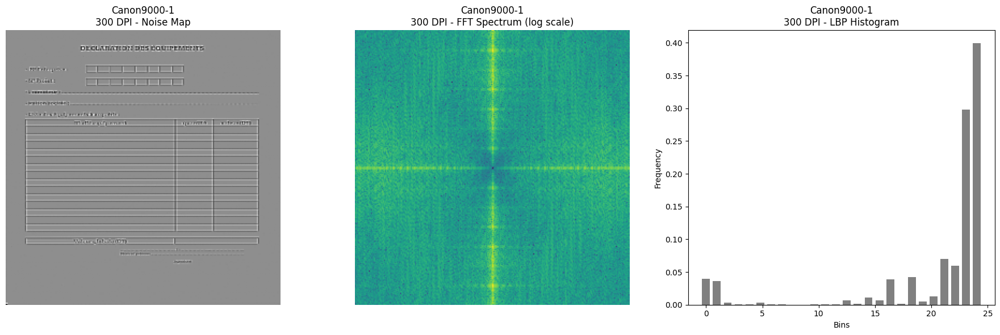

 91%|█████████ | 10/11 [00:14<00:01,  1.49s/it]

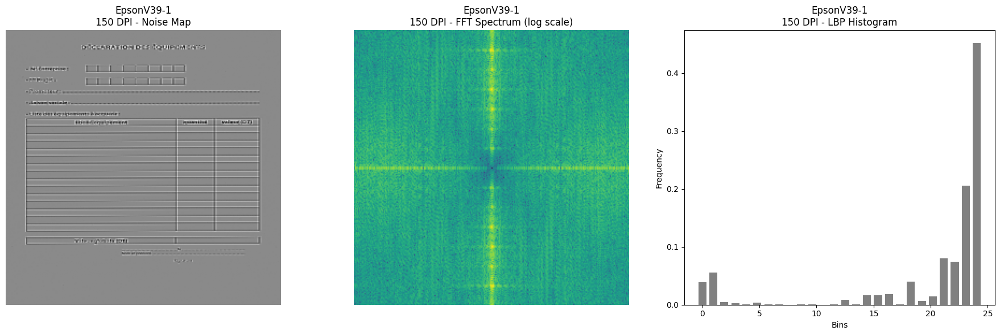

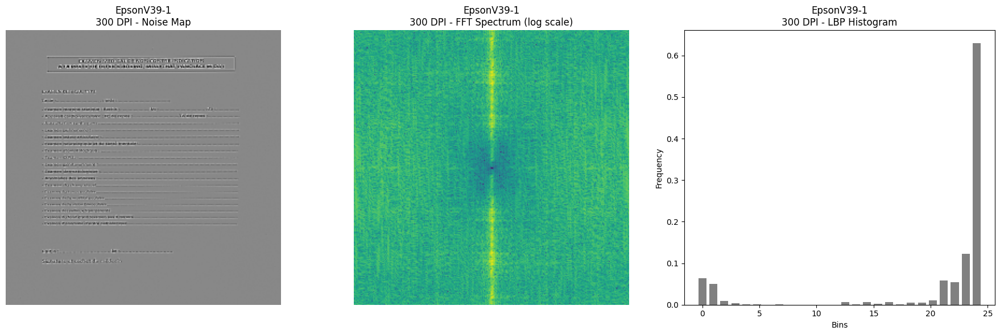

100%|██████████| 11/11 [00:15<00:00,  1.41s/it]


Processing dataset: wikipedia


100%|██████████| 11/11 [00:01<00:00,  7.26it/s]

✅ Completed feature extraction for 44 samples.
✅ Saved enhanced features to /content/drive/MyDrive/Obj1/enhanced_features.pkl


In [ ]:
#Extracting and Visualising the additional features (FFT, LBP)
import pickle
import numpy as np
from tqdm import tqdm
from skimage.feature import local_binary_pattern
from scipy import ndimage
from scipy.fft import fft2, fftshift
import matplotlib.pyplot as plt

# Paths
RES_PATH = "/content/drive/MyDrive/Obj1/residuals_official_wiki.pkl"  # changed to Obj1 for consistency
ENHANCED_OUT = "/content/drive/MyDrive/Obj1/enhanced_features.pkl"

# Load residuals
with open(RES_PATH, "rb") as f:
    residuals_dict = pickle.load(f)

# Feature extraction function
def extract_enhanced_features(residual):
    """Extract FFT freq bands, LBP hist, and texture stats."""
    # FFT Features
    fft_img = np.abs(fft2(residual))
    fft_img = fftshift(fft_img)

    h, w = fft_img.shape
    ch, cw = h // 2, w // 2

    low_freq = np.mean(fft_img[ch-20:ch+20, cw-20:cw+20])
    mid_freq = np.mean(fft_img[ch-60:ch+60, cw-60:cw+60]) - low_freq
    high_freq = np.mean(fft_img) - low_freq - mid_freq

    # LBP Features
    lbp = local_binary_pattern(residual, P=24, R=3, method='uniform')
    lbp_hist, _ = np.histogram(lbp, bins=26, range=(0, 25), density=True)

    # Texture Features
    grad_x = ndimage.sobel(residual, axis=1)
    grad_y = ndimage.sobel(residual, axis=0)
    grad_mag = np.sqrt(grad_x ** 2 + grad_y ** 2)

    texture_feats = [
        np.std(residual),
        np.mean(np.abs(residual)),
        np.std(grad_mag),
        np.mean(grad_mag),
    ]

    return [low_freq, mid_freq, high_freq] + lbp_hist.tolist() + texture_feats

# Visualization function
def visualize_sample(residual, scanner_name, dpi):
    fft_img = np.abs(fft2(residual))
    fft_img = fftshift(fft_img)
    fft_log = np.log(fft_img + 1e-8)

    lbp = local_binary_pattern(residual, P=24, R=3, method='uniform')
    lbp_hist, bins = np.histogram(lbp, bins=26, range=(0, 25), density=True)

    fig, axs = plt.subplots(1, 3, figsize=(18, 6))

    axs[0].imshow(residual, cmap='gray')
    axs[0].set_title(f"{scanner_name}\n{dpi} DPI - Noise Map")
    axs[0].axis('off')

    axs[1].imshow(fft_log, cmap='viridis')
    axs[1].set_title(f"{scanner_name}\n{dpi} DPI - FFT Spectrum (log scale)")
    axs[1].axis('off')

    axs[2].bar(bins[:-1], lbp_hist, width=0.7, color='gray')
    axs[2].set_title(f"{scanner_name}\n{dpi} DPI - LBP Histogram")
    axs[2].set_xlabel("Bins")
    axs[2].set_ylabel("Frequency")

    plt.tight_layout()
    plt.show()

# Main processing and visualization
enhanced_features = []
enhanced_labels = []

print("🔄 Extracting enhanced features and visualizing samples...")

# Visualize one sample per scanner/dpi as example
visualized = set()

for dataset_name in residuals_dict.keys():  # dynamic keys to avoid key mismatches
    print(f"Processing dataset: {dataset_name}")
    for scanner, dpi_dict in tqdm(residuals_dict[dataset_name].items()):
        for dpi, res_list in dpi_dict.items():
            for idx, res in enumerate(res_list):
                feat = extract_enhanced_features(res)
                enhanced_features.append(feat)
                enhanced_labels.append(scanner)
                # Visualize the first sample for each scanner-dpi only
                key = (scanner, dpi)
                if key not in visualized:
                    visualize_sample(res, scanner, dpi)
                    visualized.add(key)
                # Optional: break after first sample per scanner-dpi for visualization speed
                break

# Save enhanced features and labels
with open(ENHANCED_OUT, "wb") as f:
    pickle.dump({"features": enhanced_features, "labels": enhanced_labels}, f)

print(f"✅ Completed feature extraction for {len(enhanced_features)} samples.")
print(f"✅ Saved enhanced features to {ENHANCED_OUT}")


4) Baseline Model Training

In [ ]:
# Model Training based on the features extracted (SVM, RANDOM FOREST)
import pickle
import numpy as np
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score

# --- Load features and labels ---
FEATURES_PATH = "/content/drive/MyDrive/Obj1/features.pkl"
with open(FEATURES_PATH, "rb") as f:
    data = pickle.load(f)

X = np.array(data["features"], dtype=np.float32)
y = np.array(data["labels"])

# Encode labels
le = LabelEncoder()
y_enc = le.fit_transform(y)

# Train-test split
X_train, X_test, y_train, y_test = train_test_split(
    X, y_enc, test_size=0.2, random_state=42, stratify=y_enc
)

# Scale features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# --- Train baseline models ---

# Support Vector Machine
svm_clf = SVC(kernel='rbf', probability=True, random_state=42)
svm_clf.fit(X_train_scaled, y_train)
y_pred_svm = svm_clf.predict(X_test_scaled)
print("SVM Classification Report:")
print(classification_report(y_test, y_pred_svm, target_names=le.classes_))
print(f"SVM Accuracy: {accuracy_score(y_test, y_pred_svm):.4f}")

# Random Forest
rf_clf = RandomForestClassifier(n_estimators=100, random_state=42)
rf_clf.fit(X_train_scaled, y_train)
y_pred_rf = rf_clf.predict(X_test_scaled)
print("Random Forest Classification Report:")
print(classification_report(y_test, y_pred_rf, target_names=le.classes_))
print(f"Random Forest Accuracy: {accuracy_score(y_test, y_pred_rf):.4f}")

# --- Save label encoder and scaler for later ---
import joblib
joblib.dump(le, "/content/drive/MyDrive/Obj1/baseline_label_encoder.joblib")
joblib.dump(scaler, "/content/drive/MyDrive/Obj1/baseline_scaler.joblib")
print("Saved label encoder and scaler.")


SVM Classification Report:
              precision    recall  f1-score   support

  Canon120-1       0.21      0.24      0.22        83
  Canon120-2       0.27      0.19      0.22        83
    Canon220       0.64      0.73      0.69        83
 Canon9000-1       0.68      0.81      0.74        83
 Canon9000-2       0.50      0.29      0.37        82
 EpsonV370-1       0.90      0.88      0.89        83
 EpsonV370-2       0.80      0.87      0.83        84
  EpsonV39-1       0.28      0.46      0.35        83
  EpsonV39-2       0.21      0.15      0.18        84
   EpsonV550       0.88      0.88      0.88        83
          HP       0.92      0.70      0.79        83

    accuracy                           0.56       914
   macro avg       0.57      0.56      0.56       914
weighted avg       0.57      0.56      0.56       914

SVM Accuracy: 0.5646
Random Forest Classification Report:
              precision    recall  f1-score   support

  Canon120-1       0.54      0.54      0.54    

5) Hybrid CNN Model Training

In [ ]:
import os
import pickle
import random
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder, StandardScaler
from tensorflow.keras.utils import to_categorical
from skimage.feature import local_binary_pattern as sk_lbp
import cv2
import pywt
from scipy import ndimage
from scipy.fft import fft2, fftshift

# --- Paths ---
BASE_DIR = "/content/drive/MyDrive/Obj1"
RES_PATH = os.path.join(BASE_DIR, "residuals_official_wiki.pkl")
FP_PATH = os.path.join(BASE_DIR, "scanner_fingerprints.pkl")
ORDER_NPY = os.path.join(BASE_DIR, "fp_keys.npy")
ART_DIR = BASE_DIR
os.makedirs(ART_DIR, exist_ok=True)

# --- Reproducibility ---
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
tf.random.set_seed(SEED)

# --- Load data ---
with open(RES_PATH, "rb") as f:
    residuals_dict = pickle.load(f)
with open(FP_PATH, "rb") as f:
    scanner_fps = pickle.load(f)
fp_keys = np.load(ORDER_NPY, allow_pickle=True).tolist()

# --- Helper functions ---

def corr2d(a: np.ndarray, b: np.ndarray) -> float:
    a = a.astype(np.float32).ravel()
    b = b.astype(np.float32).ravel()
    a -= a.mean()
    b -= b.mean()
    denom = np.linalg.norm(a) * np.linalg.norm(b)
    return float(np.dot(a, b) / denom) if denom != 0 else 0.0

def fft_radial_energy(img: np.ndarray, K: int = 6) -> list[float]:
    f = fftshift(fft2(img))
    mag = np.abs(f)
    h, w = mag.shape
    cy, cx = h // 2, w // 2
    yy, xx = np.ogrid[:h, :w]
    r = np.sqrt((yy - cy) ** 2 + (xx - cx) ** 2)
    rmax = r.max() + 1e-6
    bins = np.linspace(0, rmax, K + 1)
    feats = []
    for i in range(K):
        mask = (r >= bins[i]) & (r < bins[i + 1])
        feats.append(float(mag[mask].mean() if np.any(mask) else 0.0))
    return feats

def lbp_hist_safe(img: np.ndarray, P: int = 8, R: float = 1.0) -> list[float]:
    rng = float(np.ptp(img))
    if rng < 1e-12:
        norm_img = np.zeros_like(img, dtype=np.float32)
    else:
        norm_img = (img - img.min()) / (rng + 1e-8)
    img_uint8 = (norm_img * 255).astype(np.uint8)
    codes = sk_lbp(img_uint8, P=P, R=R, method="uniform")
    n_bins = P + 2
    hist, _ = np.histogram(codes, bins=np.arange(n_bins + 1), density=True)
    return hist.astype(np.float32).tolist()

# --- Prepare dataset ---

X_img, X_feat, y = [], [], []
for dataset_name in residuals_dict.keys():
    for scanner, dpi_dict in residuals_dict[dataset_name].items():
        for dpi, res_list in dpi_dict.items():
            for res in res_list:
                # Image branch - expand dims for channels
                X_img.append(np.expand_dims(res, axis=-1))
                # Feature branch - concatenation of PRNU correlation, FFT energy, LBP hist
                v_corr = [corr2d(res, scanner_fps[k]) for k in fp_keys]
                v_fft = fft_radial_energy(res)
                v_lbp = lbp_hist_safe(res)
                X_feat.append(v_corr + v_fft + v_lbp)
                y.append(scanner)

X_img = np.array(X_img, dtype=np.float32)
X_feat = np.array(X_feat, dtype=np.float32)
y = np.array(y)

# --- Encode labels and split data ---
le = LabelEncoder()
y_int = le.fit_transform(y)
num_classes = len(le.classes_)
y_cat = to_categorical(y_int, num_classes)

X_img_tr, X_img_te, X_feat_tr, X_feat_te, y_tr, y_te = train_test_split(
    X_img, X_feat, y_cat, test_size=0.2, random_state=SEED, stratify=y_int
)

scaler = StandardScaler()
X_feat_tr = scaler.fit_transform(X_feat_tr)
X_feat_te = scaler.transform(X_feat_te)

# Save label encoder and scaler
with open(os.path.join(ART_DIR, "hybrid_label_encoder.pkl"), "wb") as f:
    pickle.dump(le, f)
with open(os.path.join(ART_DIR, "hybrid_feat_scaler.pkl"), "wb") as f:
    pickle.dump(scaler, f)

print(f"Training data: {X_img_tr.shape}, features: {X_feat_tr.shape}, labels: {y_tr.shape}")
print(f"Testing data: {X_img_te.shape}, features: {X_feat_te.shape}, labels: {y_te.shape}")

# --- Build Hybrid Model ---
img_input = keras.Input(shape=(256, 256, 1), name="residual_image")
feat_input = keras.Input(shape=(27,), name="handcrafted_features")

# Fixed high-pass filter (content suppression)
hp_kernel = np.array([[-1, -1, -1], [-1, 8, -1], [-1, -1, -1]], dtype=np.float32).reshape((3, 3, 1, 1))
hp = layers.Conv2D(1, (3, 3), padding="same", use_bias=False, trainable=False, name="hp_filter")(img_input)

x = layers.Conv2D(32, (3, 3), padding="same")(hp)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)
x = layers.Conv2D(32, (3, 3), padding="same", activation="relu")(x)
x = layers.MaxPooling2D((2, 2))(x)
x = layers.Dropout(0.25)(x)

x = layers.Conv2D(64, (3, 3), padding="same")(x)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)
x = layers.Conv2D(64, (3, 3), padding="same", activation="relu")(x)
x = layers.MaxPooling2D((2, 2))(x)
x = layers.Dropout(0.25)(x)

x = layers.Conv2D(128, (3, 3), padding="same")(x)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)
x = layers.Conv2D(128, (3, 3), padding="same", activation="relu")(x)
x = layers.MaxPooling2D((2, 2))(x)
x = layers.Dropout(0.30)(x)

x = layers.Conv2D(256, (3, 3), padding="same")(x)
x = layers.BatchNormalization()(x)
x = layers.ReLU()(x)
x = layers.GlobalAveragePooling2D()(x)

# Feature branch
f = layers.Dense(64)(feat_input)
f = layers.BatchNormalization()(f)
f = layers.ReLU()(f)
f = layers.Dropout(0.20)(f)

# Concatenate and classify
z = layers.Concatenate()([x, f])
z = layers.Dense(256, activation="relu")(z)
z = layers.Dropout(0.40)(z)
output = layers.Dense(num_classes, activation="softmax")(z)

model = keras.Model(inputs=[img_input, feat_input], outputs=output, name="scanner_hybrid")
model.get_layer("hp_filter").set_weights([hp_kernel])

model.compile(optimizer=keras.optimizers.Adam(1e-3),
              loss="categorical_crossentropy",
              metrics=["accuracy"])
model.summary()

# --- Prepare tf.data datasets ---
BATCH_SIZE = 32
train_ds = tf.data.Dataset.from_tensor_slices(((X_img_tr, X_feat_tr), y_tr))\
    .shuffle(buffer_size=len(y_tr), seed=SEED)\
    .batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)
val_ds = tf.data.Dataset.from_tensor_slices(((X_img_te, X_feat_te), y_te))\
    .batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

# --- Callbacks ---
CHECKPOINT_PATH = os.path.join(ART_DIR, "scanner_hybrid.keras")
callbacks = [
    keras.callbacks.EarlyStopping(monitor="val_accuracy", patience=10, restore_best_weights=True),
    keras.callbacks.ReduceLROnPlateau(monitor="val_accuracy", factor=0.5, patience=5, min_lr=1e-6),
    keras.callbacks.ModelCheckpoint(CHECKPOINT_PATH, monitor="val_accuracy", save_best_only=True)
]

# --- Train ---
EPOCHS = 50
history = model.fit(train_ds, epochs=EPOCHS, validation_data=val_ds, callbacks=callbacks, verbose=1)

# --- Save final model and history ---
FINAL_PATH = os.path.join(ART_DIR, "scanner_hybrid_final.keras")
model.save(FINAL_PATH)
with open(os.path.join(ART_DIR, "hybrid_training_history.pkl"), "wb") as f:
    pickle.dump(history.history, f)

print(f"✅ Training complete. Model saved to {FINAL_PATH}")


Training data: (3654, 256, 256, 1), features: (3654, 27), labels: (3654, 11)
Testing data: (914, 256, 256, 1), features: (914, 27), labels: (914, 11)


Model: "scanner_hybrid"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ residual_image      │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ hp_filter (Conv2D)  │ (None, 256, 256,  │          9 │ residual_image[0… │
│                     │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │        320 │ hp_filter[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256, 256,  │        128 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 256, 256,  │      9,248 │ re_lu[0][0]       │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 128, 128,  │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 128, 128,  │          0 │ max_pooling2d[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 128, 128,  │     18,496 │ dropout[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 128, 128,  │        256 │ conv2d_2[0][0]    │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 128, 128,  │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 128, 128,  │     36,928 │ re_lu_1[0][0]     │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 64, 64,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 64, 64,    │          0 │ max_pooling2d_1[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │     73,856 │ dropout_1[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │        512 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_2 (ReLU)      │ (None, 64, 64,    │          0 │ batch_normalizat

 Total params: 670,580 (2.56 MB)

 Trainable params: 669,483 (2.55 MB)

 Non-trainable params: 1,097 (4.29 KB)

Epoch 1/50
115/115 ━━━━━━━━━━━━━━━━━━━━ 76s 384ms/step - accuracy: 0.2863 - loss: 2.0070 - val_accuracy: 0.3884 - val_loss: 1.6370 - learning_rate: 0.0010
Epoch 2/50
115/115 ━━━━━━━━━━━━━━━━━━━━ 20s 177ms/step - accuracy: 0.4520 - loss: 1.4065 - val_accuracy: 0.5350 - val_loss: 1.2059 - learning_rate: 0.0010
Epoch 3/50
115/115 ━━━━━━━━━━━━━━━━━━━━ 20s 177ms/step - accuracy: 0.5142 - loss: 1.2697 - val_accuracy: 0.5011 - val_loss: 1.2490 - learning_rate: 0.0010
Epoch 4/50
115/115 ━━━━━━━━━━━━━━━━━━━━ 21s 180ms/step - accuracy: 0.5287 - loss: 1.1883 - val_accuracy: 0.5919 - val_loss: 1.0494 - learning_rate: 0.0010
Epoch 5/50
115/115 ━━━━━━━━━━━━━━━━━━━━ 21s 180ms/step - accuracy: 0.5489 - loss: 1.1399 - val_accuracy: 0.5591 - val_loss: 1.1758 - learning_rate: 0.0010
Epoch 6/50
115/115 ━━━━━━━━━━━━━━━━━━━━ 21s 180ms/step - accuracy: 0.5885 - loss: 1.0432 - val_accuracy: 0.4694 - val_loss: 1.3629 - learning_rate: 0.0010
Epoch 7/50
115/115 ━━━━━━━━━━━━━━━━━━━━ 21s 181ms/step - accuracy: 0.6

29/29 ━━━━━━━━━━━━━━━━━━━━ 3s 68ms/step
Classification Report (present labels):

              precision    recall  f1-score   support

  Canon120-1       0.96      0.90      0.93        83
  Canon120-2       0.88      0.96      0.92        83
    Canon220       0.98      0.95      0.96        83
 Canon9000-1       0.97      0.82      0.89        83
 Canon9000-2       0.84      0.98      0.90        82
 EpsonV370-1       0.99      0.98      0.98        83
 EpsonV370-2       0.98      0.99      0.98        84
  EpsonV39-1       0.97      0.94      0.96        83
  EpsonV39-2       0.95      0.98      0.96        84
   EpsonV550       1.00      1.00      1.00        83
          HP       1.00      1.00      1.00        83

    accuracy                           0.95       914
   macro avg       0.96      0.95      0.95       914
weighted avg       0.96      0.95      0.95       914

Overall Accuracy: 0.9540



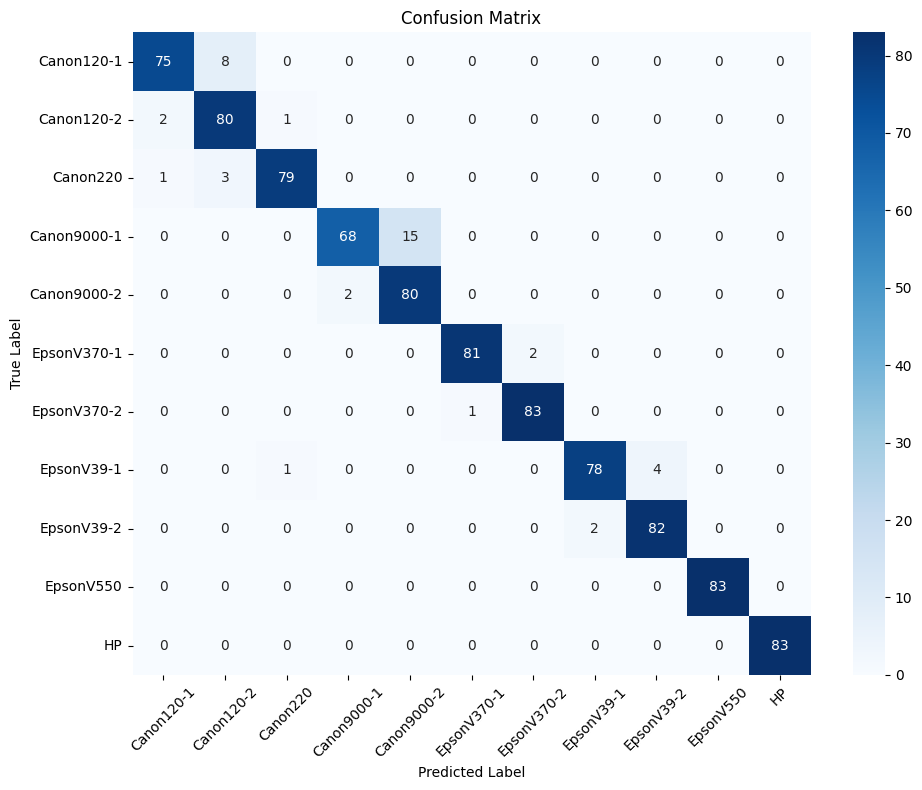

In [ ]:
#Evaluation (metrics)
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score
from sklearn.preprocessing import LabelEncoder
from sklearn.utils.multiclass import unique_labels
import pickle
import tensorflow as tf

# --- Load artifacts (adjust paths accordingly) ---
ART_DIR = "/content/drive/MyDrive/Obj1"
MODEL_PATH = f"{ART_DIR}/scanner_hybrid.keras"
LE_PATH = f"{ART_DIR}/hybrid_label_encoder.pkl"
SCALER_PATH = f"{ART_DIR}/hybrid_feat_scaler.pkl"

# Load the trained model
model = tf.keras.models.load_model(MODEL_PATH)

# Load LabelEncoder
with open(LE_PATH, "rb") as f:
    le = pickle.load(f)

# Load scaler
with open(SCALER_PATH, "rb") as f:
    scaler = pickle.load(f)

# Assuming your test data is already loaded as:
# X_img_te (np.array of shape (num_samples, 256,256,1))
# X_feat_te (np.array of shape (num_samples, 27))
# y_te (one-hot encoded labels of shape (num_samples, num_classes))

# --- Predict on test data ---
probs = model.predict([X_img_te, X_feat_te], batch_size=32, verbose=1)
y_pred_int = np.argmax(probs, axis=1)
y_true_int = np.argmax(y_te, axis=1)

# Decode integer labels to class names
y_pred = le.inverse_transform(y_pred_int)
y_true = le.inverse_transform(y_true_int)

# Compute metrics
def show_metrics(y_true, y_pred, label_classes):
    present_labels = unique_labels(y_true, y_pred)

    print("Classification Report (present labels):\n")
    print(classification_report(y_true, y_pred, labels=present_labels, zero_division=0))

    accuracy = accuracy_score(y_true, y_pred)
    print(f"Overall Accuracy: {accuracy:.4f}\n")

    cm = confusion_matrix(y_true, y_pred, labels=present_labels)
    plt.figure(figsize=(10,8))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=present_labels, yticklabels=present_labels)
    plt.xlabel("Predicted Label")
    plt.ylabel("True Label")
    plt.title("Confusion Matrix")
    plt.xticks(rotation=45)
    plt.yticks(rotation=0)
    plt.tight_layout()
    plt.show()

# Display the metrics and confusion matrix
show_metrics(y_true, y_pred, list(le.classes_))


In [ ]:
#Testing function
import os
import numpy as np
import tensorflow as tf
import pickle
import cv2
import pywt
from scipy import ndimage
from scipy.fft import fft2, fftshift
from skimage.feature import local_binary_pattern as sk_lbp

# --- Paths: update as necessary ---
ART_DIR = "/content/drive/MyDrive/Obj1"
FP_PATH = os.path.join(ART_DIR, "scanner_fingerprints.pkl")
ORDER_NPY = os.path.join(ART_DIR, "fp_keys.npy")
MODEL_PATH = os.path.join(ART_DIR, "scanner_hybrid.keras")
ENCODER_PATH = os.path.join(ART_DIR, "hybrid_label_encoder.pkl")
SCALER_PATH = os.path.join(ART_DIR, "hybrid_feat_scaler.pkl")

IMG_SIZE = (256, 256)

# --- Load model and artifacts ---
model = tf.keras.models.load_model(MODEL_PATH)
with open(ENCODER_PATH, "rb") as f:
    le = pickle.load(f)
with open(SCALER_PATH, "rb") as f:
    scaler = pickle.load(f)
with open(FP_PATH, "rb") as f:
    scanner_fps = pickle.load(f)
fp_keys = np.load(ORDER_NPY, allow_pickle=True).tolist()

# --- Helper functions ---

def preprocess_residual_pywt(path: str) -> np.ndarray:
    img = cv2.imread(path, cv2.IMREAD_UNCHANGED)
    if img is None:
        raise ValueError(f"Cannot read image at {path}")
    if img.ndim == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img = cv2.resize(img, IMG_SIZE, interpolation=cv2.INTER_AREA)
    img = img.astype(np.float32) / 255.0
    # Haar wavelet denoising
    cA, (cH, cV, cD) = pywt.dwt2(img, 'haar')
    cH.fill(0)
    cV.fill(0)
    cD.fill(0)
    denoised = pywt.idwt2((cA, (cH, cV, cD)), 'haar')
    residual = img - denoised
    return residual.astype(np.float32)

def corr2d(a: np.ndarray, b: np.ndarray) -> float:
    a = a.ravel()
    b = b.ravel()
    a = a - a.mean()
    b = b - b.mean()
    denom = np.linalg.norm(a) * np.linalg.norm(b)
    return float(np.dot(a, b) / denom) if denom != 0 else 0.0

def fft_radial_energy(img: np.ndarray, K: int = 6) -> list:
    f = fftshift(fft2(img))
    mag = np.abs(f)
    h, w = mag.shape
    cy, cx = h // 2, w // 2
    yy, xx = np.ogrid[:h, :w]
    r = np.sqrt((yy - cy) ** 2 + (xx - cx) ** 2)
    rmax = r.max() + 1e-6
    bins = np.linspace(0, rmax, K + 1)
    feats = []
    for i in range(K):
        mask = (r >= bins[i]) & (r < bins[i + 1])
        feats.append(float(mag[mask].mean() if np.any(mask) else 0.0))
    return feats

def lbp_hist_safe(img: np.ndarray, P: int = 8, R: float = 1.0) -> list:
    rng = float(np.ptp(img))
    if rng < 1e-12:
        g = np.zeros_like(img, dtype=np.float32)
    else:
        g = (img - img.min()) / (rng + 1e-8)
    g8 = (g * 255).astype(np.uint8)
    codes = sk_lbp(g8, P=P, R=R, method="uniform")
    n_bins = P + 2
    hist, _ = np.histogram(codes, bins=np.arange(n_bins + 1), density=True)
    return hist.astype(np.float32).tolist()

def make_feats_from_res(res: np.ndarray) -> np.ndarray:
    v_corr = [corr2d(res, scanner_fps[k]) for k in fp_keys]   # PRNU correlations
    v_fft = fft_radial_energy(res, K=6)
    v_lbp = lbp_hist_safe(res, P=8, R=1.0)
    feats = np.array(v_corr + v_fft + v_lbp, dtype=np.float32).reshape(1, -1)
    feats_scaled = scaler.transform(feats)
    return feats_scaled

# --- Prediction function ---

def predict_scanner(image_path: str):
    residual = preprocess_residual_pywt(image_path)
    x_img = np.expand_dims(residual, axis=(0, -1))   # (1, 256, 256, 1)
    x_feat = make_feats_from_res(residual)           # (1, 27)
    prob = model.predict([x_img, x_feat], verbose=0).ravel()
    top_idx = int(np.argmax(prob))
    label = le.classes_[top_idx]
    confidence = float(prob[top_idx] * 100.0)
    return label, confidence

# --- Example usage ---
if __name__ == "__main__":
    test_image_path = "/content/drive/MyDrive/Obj1/Wikipedia/Canon9000-2/300/s5_108.tif"  # Replace with your image path
    label, conf = predict_scanner(test_image_path)
    print(f"Predicted scanner: {label} with confidence: {conf:.2f}%")


Predicted scanner: Canon9000-2 with confidence: 91.99%
